In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.autonotebook import tqdm
from joblib import Parallel, delayed
import umap
import pandas as pd

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


In [3]:
from avgn.utils.paths import DATA_DIR, most_recent_subdirectory, ensure_dir

In [4]:
DATASET_ID = 'buckeye'

In [5]:
from avgn.utils.hparams import HParams
from avgn.dataset import DataSet

In [6]:
from avgn.signalprocessing.create_spectrogram_dataset import prepare_wav, create_label_df, get_row_audio

### create dataset

In [7]:
hparams = HParams(
    num_mel_bins = 32,
    mel_lower_edge_hertz=100,
    mel_upper_edge_hertz=7998,
    butter_lowcut = 100,
    butter_highcut = 7998,
    ref_level_db = 20,
    min_level_db = -40,
    mask_spec = True,
    win_length_ms = 4.0,
    hop_length_ms = 1.0,
    n_jobs = -1,
    verbosity=1,
    nex = -1
)

In [8]:
# create a dataset object
dataset = DataSet(DATASET_ID, hparams = hparams)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done 152 tasks      | elapsed:   11.1s


[Parallel(n_jobs=-1)]: Done 254 out of 254 | elapsed:   12.0s finished


In [9]:
dataset.sample_json

OrderedDict([('species', 'Homo sapien'),
             ('age', 'o'),
             ('sex', 'f'),
             ('common_name', 'Human'),
             ('samplerate_hz', 16000),
             ('length_s', 587.8899375),
             ('wav_loc',
              '/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/processed/buckeye/2019-10-08_21-32-02/WAV/s0702b.WAV'),
             ('indvs',
              OrderedDict([('s07',
                            OrderedDict([('words',
                                          OrderedDict([('start_times',
                                                        [4.885333,
                                                         5.698899,
                                                         5.903525,
                                                         6.255056,
                                                         6.526125,
                                                         6.640816,
                                                    

In [10]:
n_jobs = -1
verbosity=1

In [11]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    syllable_dfs = parallel(
        delayed(phonemes)(
            dataset.data_files[key].data,
            hparams=dataset.hparams,
            labels_to_retain=[
                "labels",
                "utterance_number",
                "PoS",
                "position_in_utterance",
            ],
            unit="words",
            dict_features_to_retain=["age", "sex"],
            key=key,
        )
        for key in tqdm(dataset.data_files.keys())
    )
syllable_df = pd.concat(syllable_dfs)
len(syllable_df)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 152 tasks      | elapsed:   18.5s


[Parallel(n_jobs=-1)]: Done 254 out of 254 | elapsed:   30.5s finished


283728

In [12]:
from joblib import Parallel, delayed
n_jobs = -1; verbosity = 1

In [13]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    syllable_dfs = parallel(
        delayed(create_label_df)(
            dataset.data_files[key].data,
            hparams=dataset.hparams,
            labels_to_retain=['labels', 'utterance_number', 'PoS', 'position_in_utterance'],
            unit="words",
            dict_features_to_retain = ['age', 'sex'],
            key = key,
        )
        for key in tqdm(dataset.data_files.keys())
    )
syllable_df = pd.concat(syllable_dfs)
len(syllable_df)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 152 tasks      | elapsed:   18.6s


[Parallel(n_jobs=-1)]: Done 254 out of 254 | elapsed:   30.9s finished


283728

In [14]:
syllable_df[:3]

,start_time,end_time,labels,utterance_number,PoS,position_in_utterance,indv,indvi,age,sex,key
0,4.885333,5.255262,well,0,RB,0,s07,0,o,f,s0702b
1,5.698899,5.903525,yknow,0,PRP_VBP,2,s07,0,o,f,s0702b
2,5.903525,6.099023,it,0,PRP,3,s07,0,o,f,s0702b


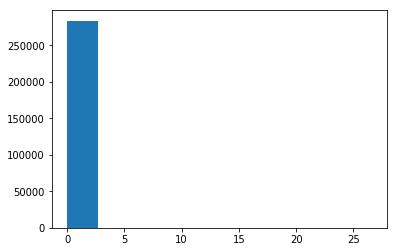

In [15]:
plt.hist(np.array(syllable_df.end_time.values - syllable_df.start_time.values));

In [16]:
syllable_df = syllable_df[syllable_df.end_time.values - syllable_df.start_time.values < 3]

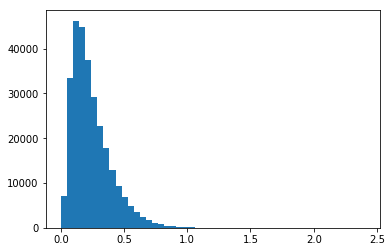

In [17]:
plt.hist(np.array(syllable_df.end_time.values - syllable_df.start_time.values), bins=50);

In [18]:
syllable_df = syllable_df[syllable_df.end_time.values - syllable_df.start_time.values > 0.005]

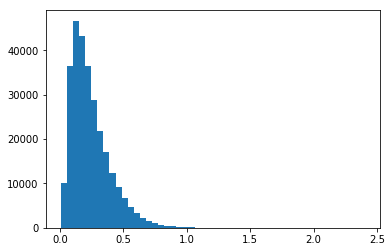

In [19]:
plt.hist(np.array(syllable_df.end_time.values - syllable_df.start_time.values), bins=50);

### get audio for dataset

In [20]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    syllable_dfs = parallel(
        delayed(get_row_audio)(
            syllable_df[syllable_df.key == key], 
            dataset.data_files[key].data['wav_loc'], 
            dataset.hparams
        )
        for key in tqdm(syllable_df.key.unique())
    )
syllable_df = pd.concat(syllable_dfs)
len(syllable_df)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 152 tasks      | elapsed:   20.3s


[Parallel(n_jobs=-1)]: Done 254 out of 254 | elapsed:   31.7s finished


283718

In [21]:
syllable_df[:3]

,start_time,end_time,labels,utterance_number,PoS,position_in_utterance,indv,indvi,age,sex,key,audio,rate
0,4.885333,5.255262,well,0,RB,0,s07,0,o,f,s0702b,"[-0.0019976329461109253, -0.001667859911609773...",16000
1,5.698899,5.903525,yknow,0,PRP_VBP,2,s07,0,o,f,s0702b,"[0.0003402321479013832, -0.0015044300901946254...",16000
2,5.903525,6.099023,it,0,PRP,3,s07,0,o,f,s0702b,"[-0.0745032684482881, -0.03571345688288944, -0...",16000


In [22]:
sylls = syllable_df.audio.values

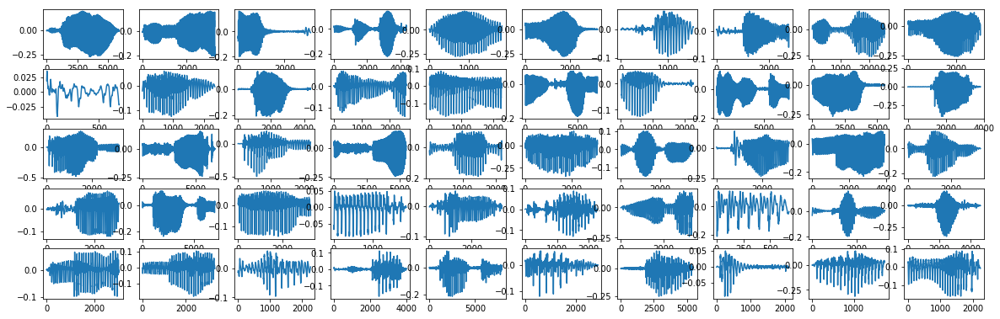

In [23]:
nrows = 5
ncols = 10
zoom = 2
fig, axs = plt.subplots(ncols=ncols, nrows = nrows,figsize = (ncols*zoom, nrows+zoom/1.5))
for i, syll in tqdm(enumerate(sylls), total = nrows*ncols):
    ax = axs.flatten()[i]
    ax.plot(syll)
    if i == nrows*ncols -1:
        break

In [24]:
syll_lens = np.array([len(i) for i in tqdm(syllable_df.audio.values)])

In [25]:
syllable_df = syllable_df[syll_lens > 100]

In [26]:
syllable_df['audio'] = [i/np.max(i) for i in tqdm(syllable_df.audio.values)]

### Create spectrograms

In [27]:
from avgn.visualization.spectrogram import draw_spec_set
from avgn.signalprocessing.create_spectrogram_dataset import make_spec, mask_spec, log_resize_spec, pad_spectrogram

In [28]:
syllables_wav = syllable_df.audio.values
syllables_rate = syllable_df.rate.values

In [29]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    # create spectrograms
    syllables_spec = parallel(
        delayed(make_spec)(
            syllable,
            rate,
            hparams=dataset.hparams,
            mel_matrix=dataset.mel_matrix,
            use_mel=True,
            use_tensorflow=False,
        )
        for syllable, rate in tqdm(
            zip(syllables_wav, syllables_rate),
            total=len(syllables_rate),
            desc="getting syllable spectrograms",
            leave=False,
        )
    )

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 5232 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 10832 tasks      | elapsed:    6.0s
[Parallel(n_jobs=-1)]: Done 18032 tasks      | elapsed:    9.4s
[Parallel(n_jobs=-1)]: Done 26832 tasks      | elapsed:   13.6s
[Parallel(n_jobs=-1)]: Done 37232 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 49232 tasks      | elapsed:   24.7s
[Parallel(n_jobs=-1)]: Done 62832 tasks      | elapsed:   31.6s
[Parallel(n_jobs=-1)]: Done 78032 tasks      | elapsed:   39.1s
[Parallel(n_jobs=-1)]: Done 94832 tasks      | elapsed:   47.3s
[Parallel(n_jobs=-1)]: Done 113232 tasks      | elapsed:   56.6s
[Parallel(n_jobs=-1)]: Done 133232 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 154832 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 

[Parallel(n_jobs=-1)]: Done 283596 out of 283596 | elapsed:  2.4min finished


### Rescale spectrogram
- using log rescaling

In [30]:
log_scaling_factor = 4

In [31]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    syllables_spec = parallel(
        delayed(log_resize_spec)(spec, scaling_factor=log_scaling_factor)
        for spec in tqdm(syllables_spec, desc="scaling spectrograms", leave=False)
    )

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 4416 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 14916 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 29616 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 48516 tasks      | elapsed:    9.6s
[Parallel(n_jobs=-1)]: Done 71616 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 98916 tasks      | elapsed:   19.1s
[Parallel(n_jobs=-1)]: Done 130416 tasks      | elapsed:   25.0s
[Parallel(n_jobs=-1)]: Done 166116 tasks      | elapsed:   31.4s
[Parallel(n_jobs=-1)]: Done 206016 tasks      | elapsed:   39.0s
[Parallel(n_jobs=-1)]: Done 250116 tasks      | elapsed:   47.2s


[Parallel(n_jobs=-1)]: Done 283596 out of 283596 | elapsed:   53.5s finished


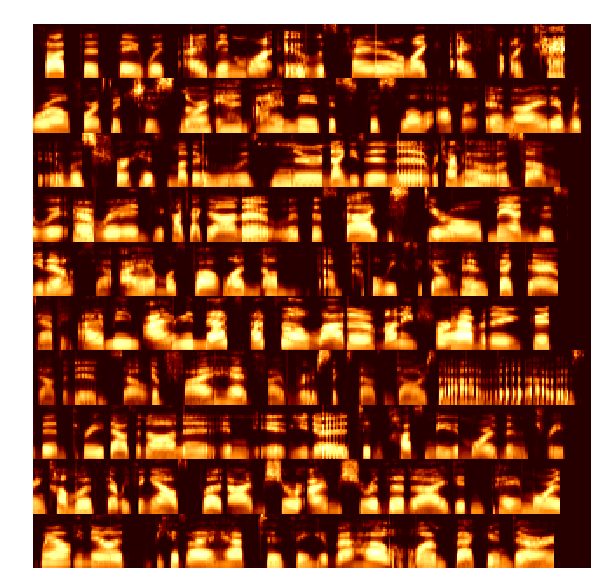

In [32]:
draw_spec_set(syllables_spec, zoom=1, maxrows=10, colsize=10)

### Pad spectrograms

In [33]:
syll_lens = [np.shape(i)[1] for i in syllables_spec]
pad_length = np.max(syll_lens)

In [34]:
#syllable_df = syllable_df[np.array(syll_lens) < 25]

In [35]:
np.max(syll_lens)

31

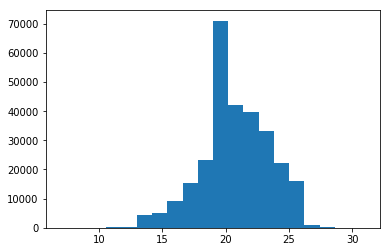

In [36]:
plt.hist(syll_lens, bins=20);

In [37]:
len(syllable_df)

283596

In [38]:
import seaborn as sns

In [39]:
#for indv in np.unique(syllable_df.labels):
#    sns.distplot(np.log(syllable_df[syllable_df.labels==indv]["end_time"] - syllable_df[syllable_df.labels==indv]["start_time"]), label=indv)
#plt.legend();

In [40]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:

    syllables_spec = parallel(
        delayed(pad_spectrogram)(spec, pad_length)
        for spec in tqdm(
            syllables_spec, desc="padding spectrograms", leave=False
        )
    )

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done 1882 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 32882 tasks      | elapsed:    5.7s
[Parallel(n_jobs=-1)]: Done 76282 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done 132082 tasks      | elapsed:   16.8s
[Parallel(n_jobs=-1)]: Done 200282 tasks      | elapsed:   24.3s


[Parallel(n_jobs=-1)]: Done 283596 out of 283596 | elapsed:   33.4s finished


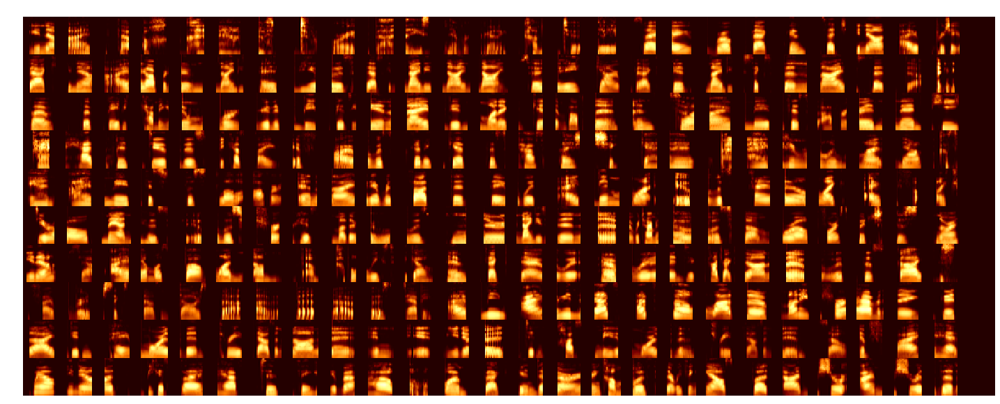

In [41]:
draw_spec_set(syllables_spec, zoom=1, maxrows=10, colsize=25)

In [42]:
np.shape(syllables_spec)

(283596, 32, 31)

In [43]:
def norm(x):
    return (x - np.min(x)) / (np.max(x) - np.min(x))

def remove_med(x):
    x[x<=np.median(x)] = 0
    return x

syllables_spec = [(norm(i)*255).astype('uint8') for i in tqdm(syllables_spec)]
#syllables_spec = [remove_med(i) for i in tqdm(syllables_spec)]

In [44]:
syllable_df['spectrogram'] = syllables_spec

In [45]:
syllable_df[:3]

,start_time,end_time,labels,utterance_number,PoS,position_in_utterance,indv,indvi,age,sex,key,audio,rate,spectrogram
0,4.885333,5.255262,well,0,RB,0,s07,0,o,f,s0702b,"[-0.009891687687084304, -0.008258749127846935,...",16000,"[[6, 6, 6, 6, 7, 41, 36, 1, 64, 165, 171, 164,..."
1,5.698899,5.903525,yknow,0,PRP_VBP,2,s07,0,o,f,s0702b,"[0.0020050267415568897, -0.00886577761757358, ...",16000,"[[4, 4, 4, 4, 4, 86, 134, 142, 150, 150, 125, ..."
2,5.903525,6.099023,it,0,PRP,3,s07,0,o,f,s0702b,"[-0.4616742369795508, -0.22130549839909638, -0...",16000,"[[5, 5, 5, 5, 5, 127, 134, 133, 133, 135, 140,..."


### view syllables per indv

In [46]:
syllable_df.indv.unique()

array(['s07', 's02', 's06', 's03', 's27', 's22', 's26', 's23', 's09',
       's20', 's25', 's08', 's21', 's24', 's29', 's05', 's28', 's01',
       's04', 's36', 's40', 's16', 's12', 's11', 's39', 's15', 's19',
       's35', 's37', 's32', 's33', 's17', 's13', 's10', 's14', 's38',
       's30', 's31', 's34', 's18'], dtype=object)

s01 4679


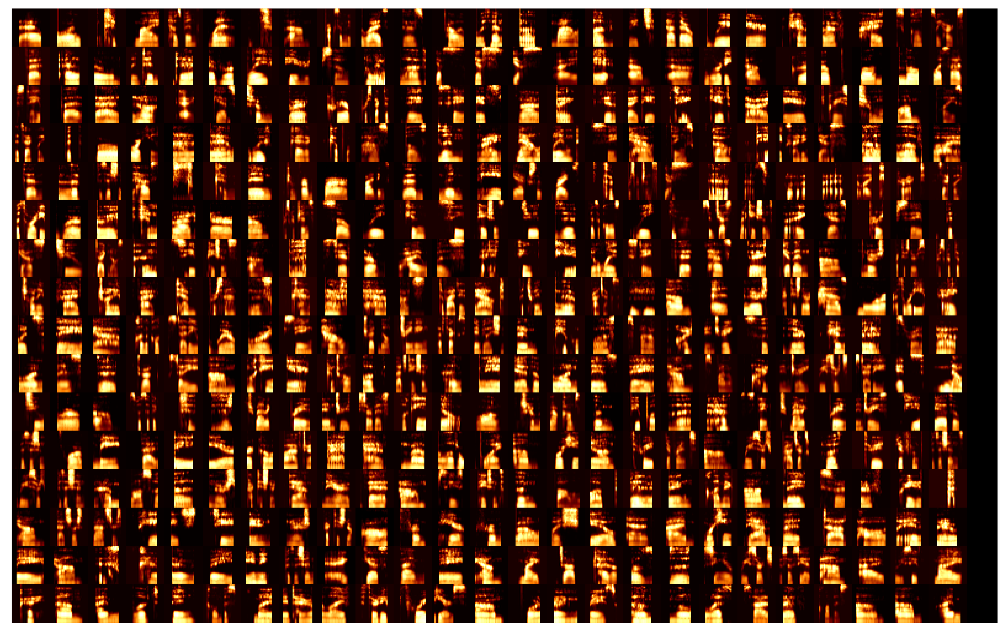

s02 7190


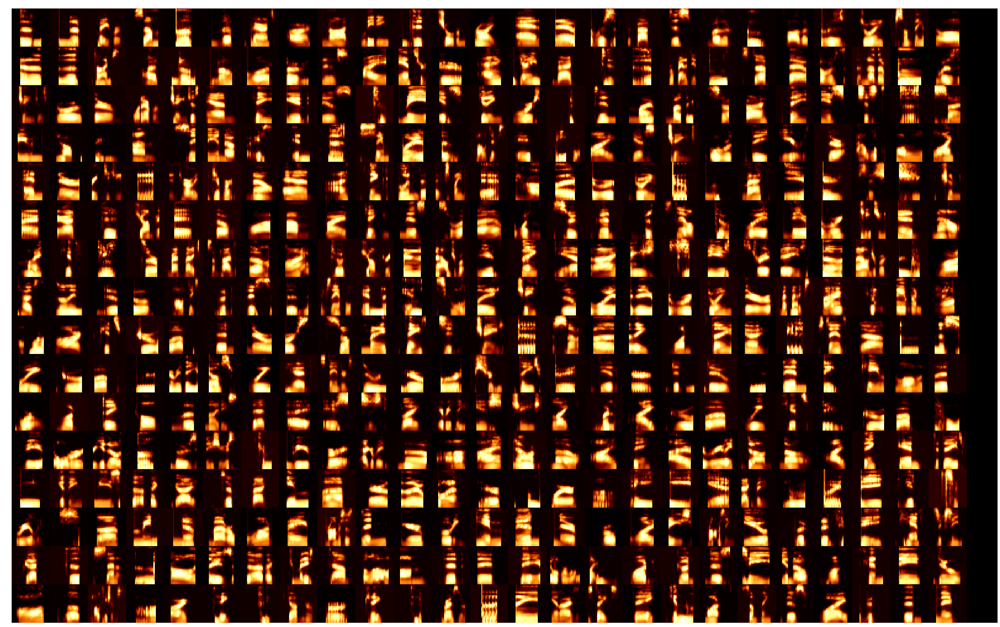

s03 5594


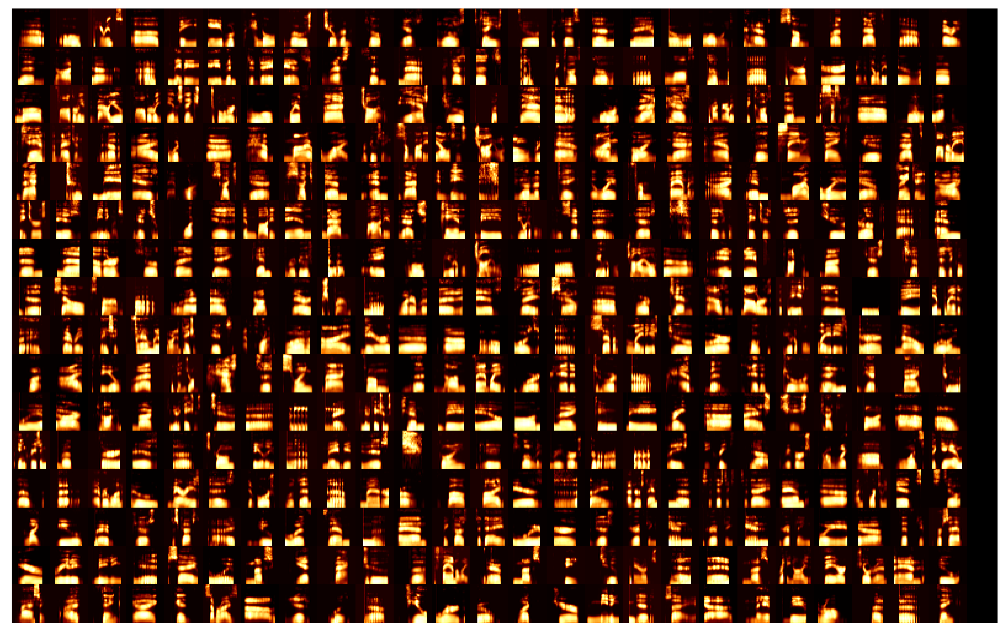

s04 7015


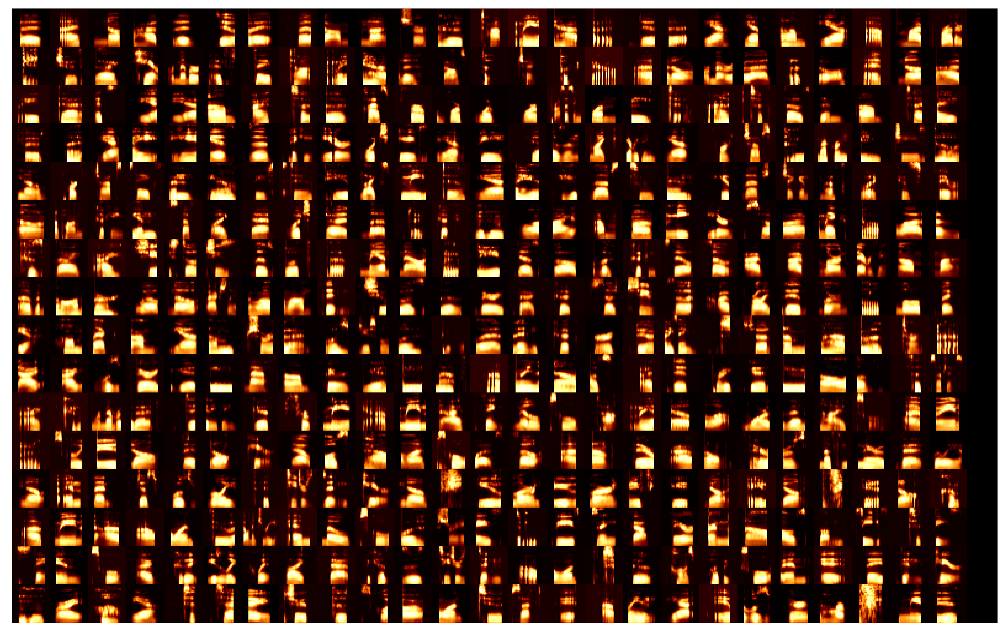

s05 5529


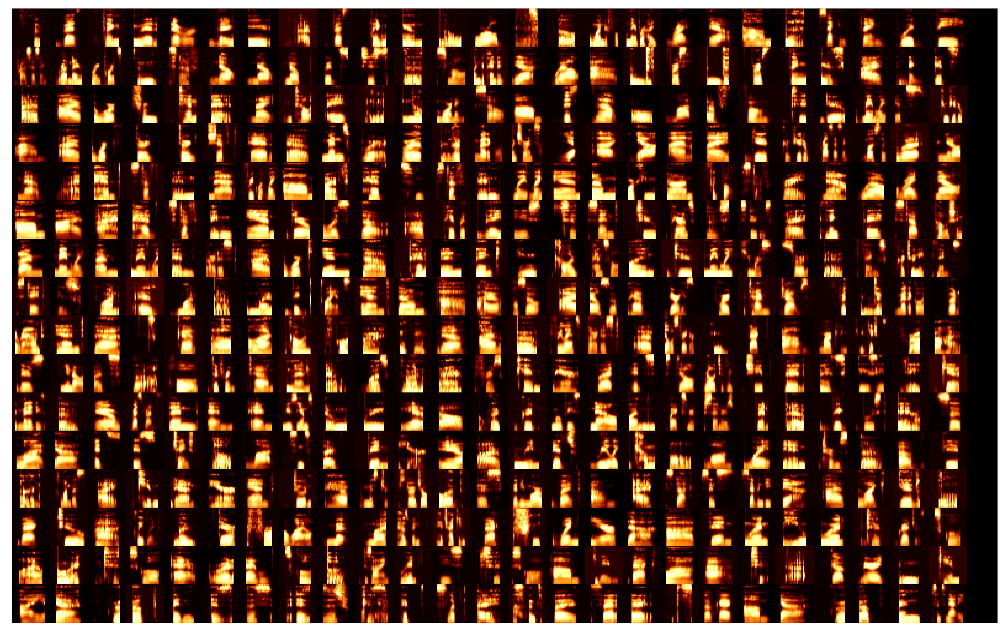

s06 3311


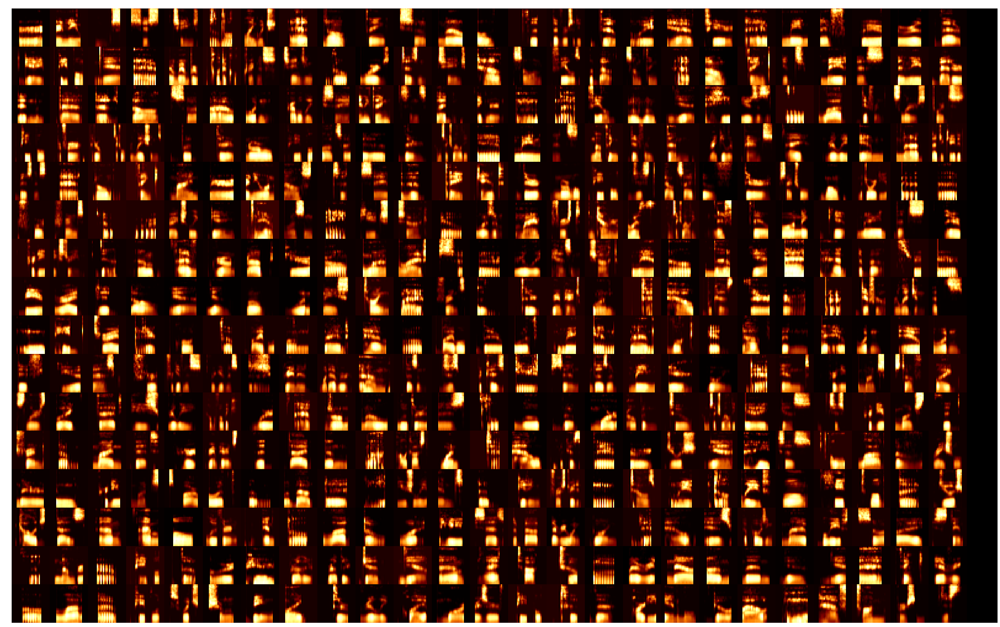

s07 9797


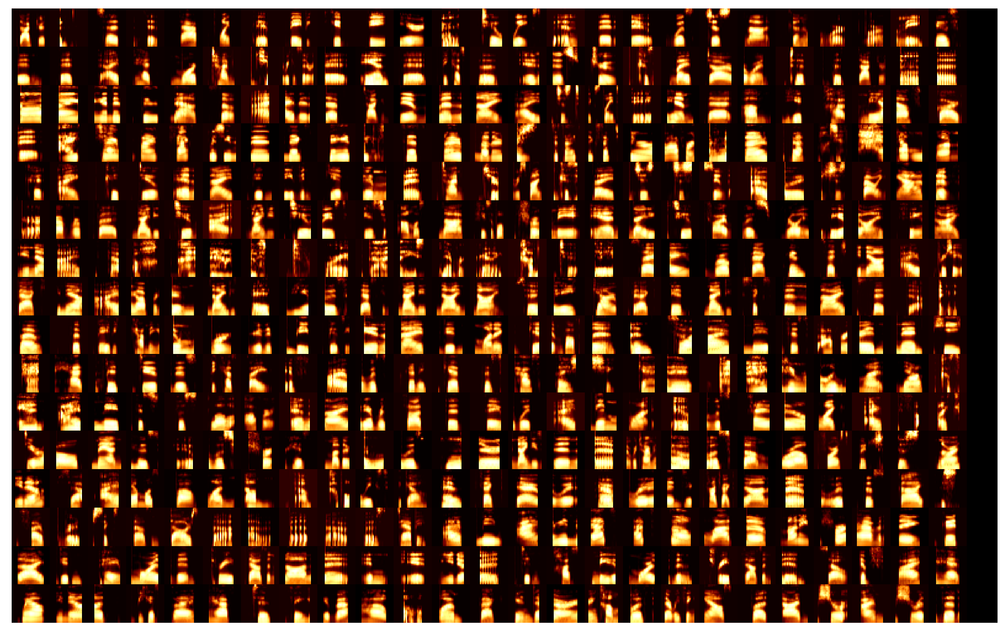

s08 7740


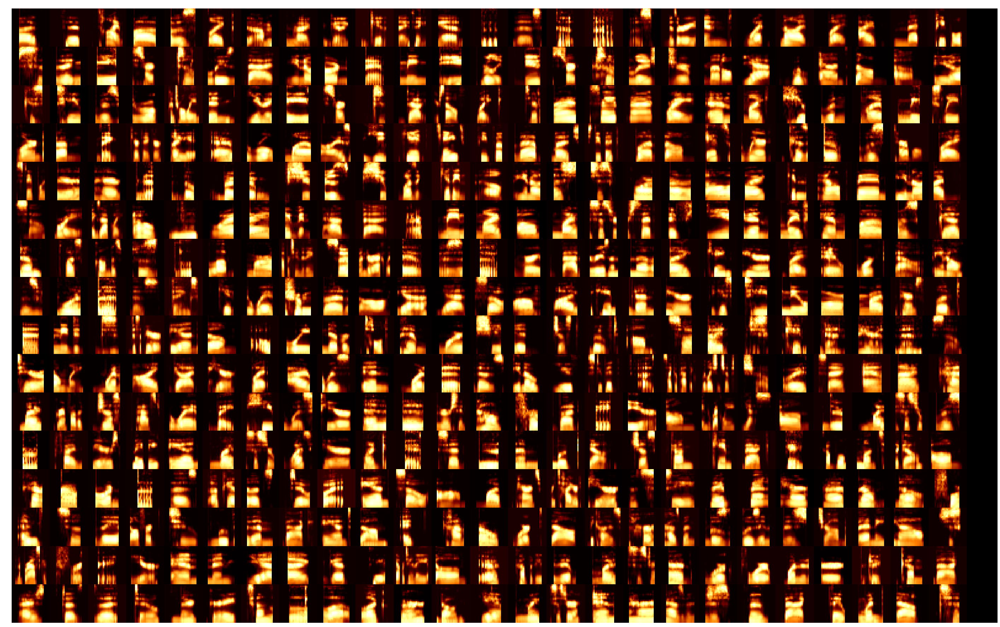

s09 6368


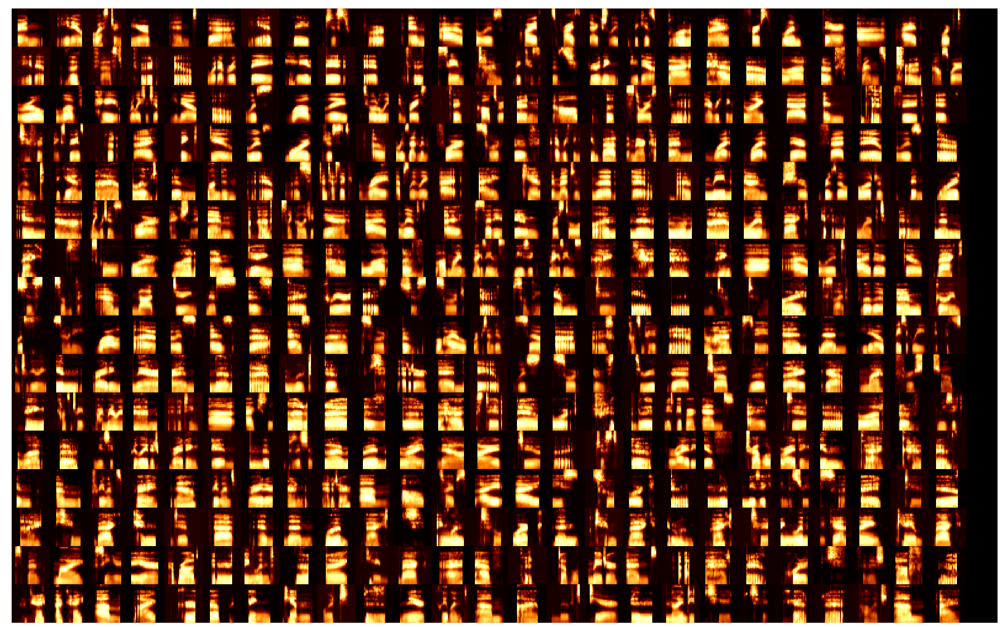

s10 11034


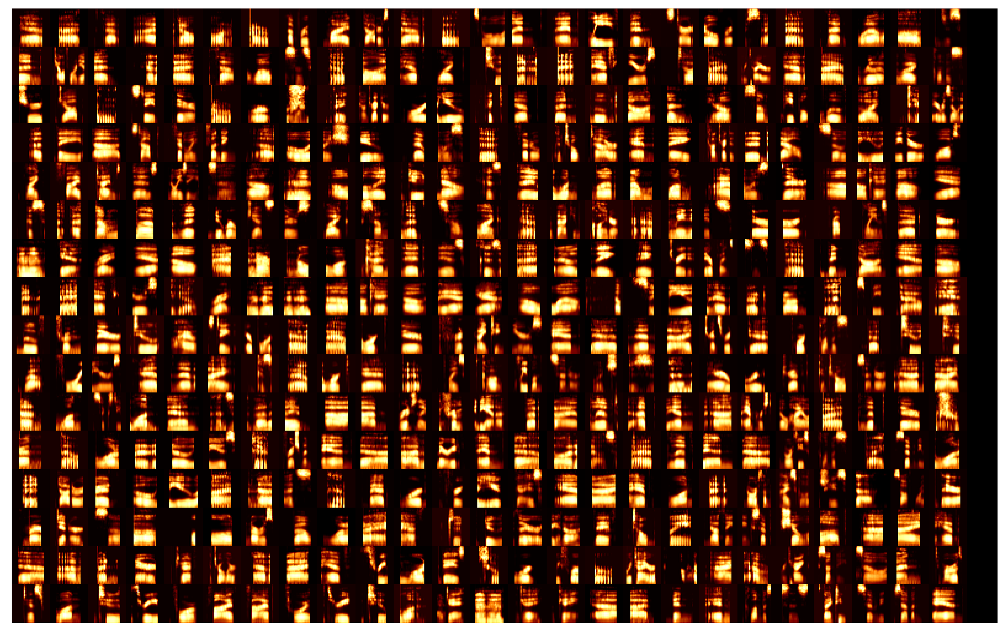

s11 7116


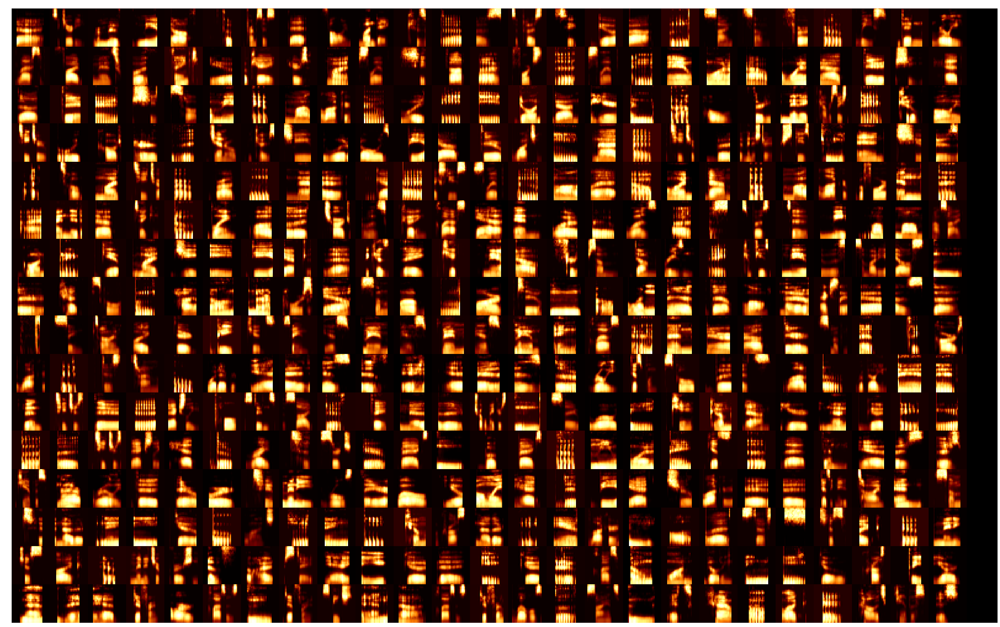

s12 9371


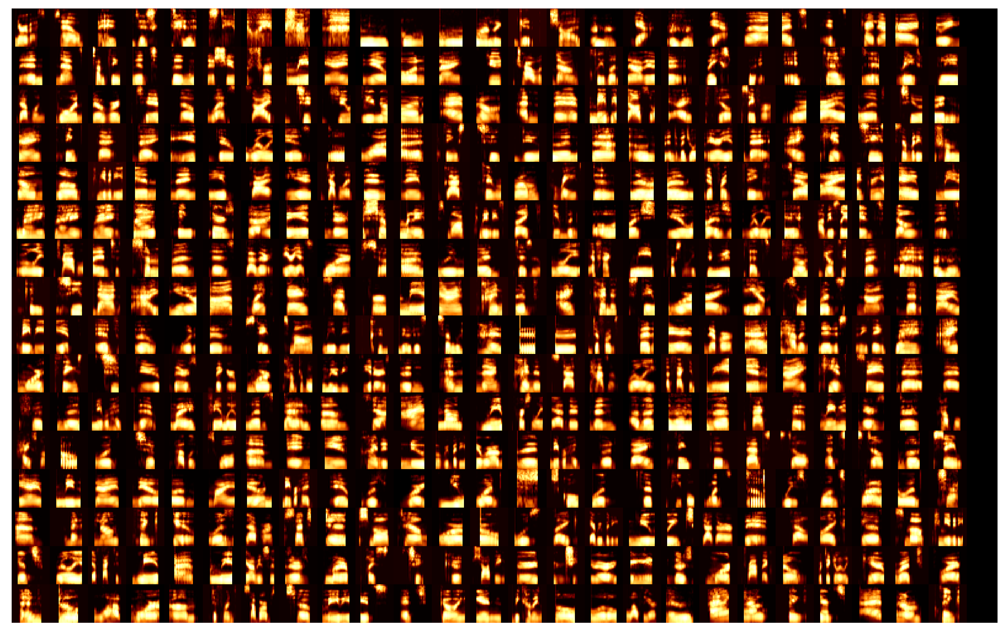

s13 9177


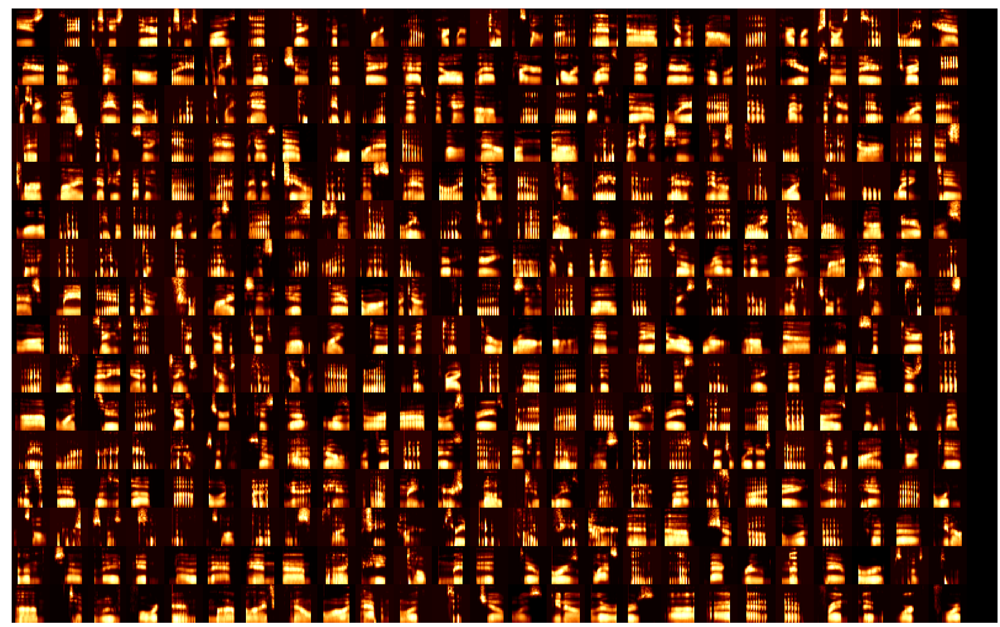

s14 8404


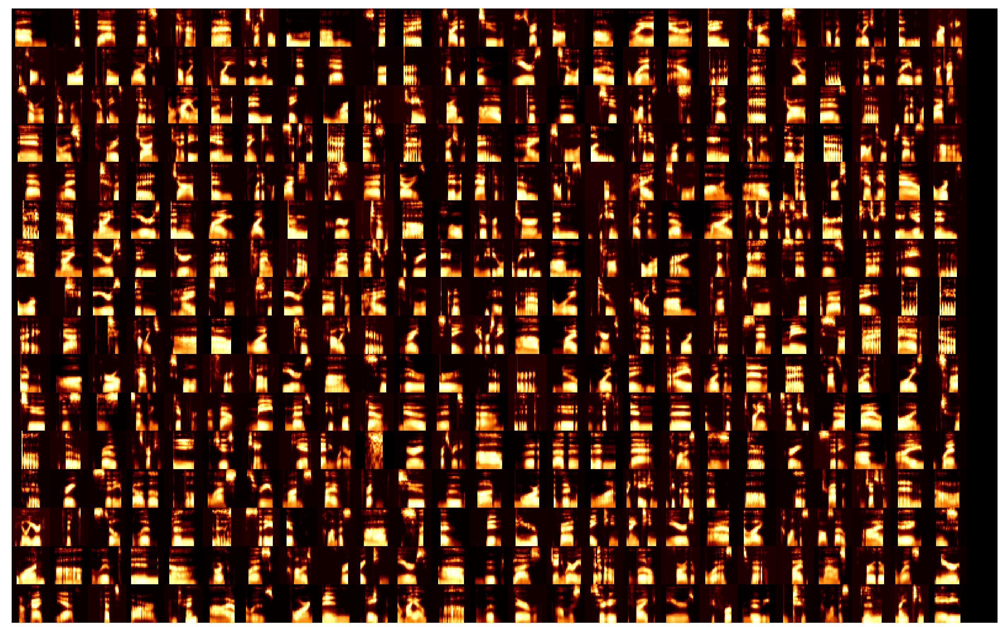

s15 8275


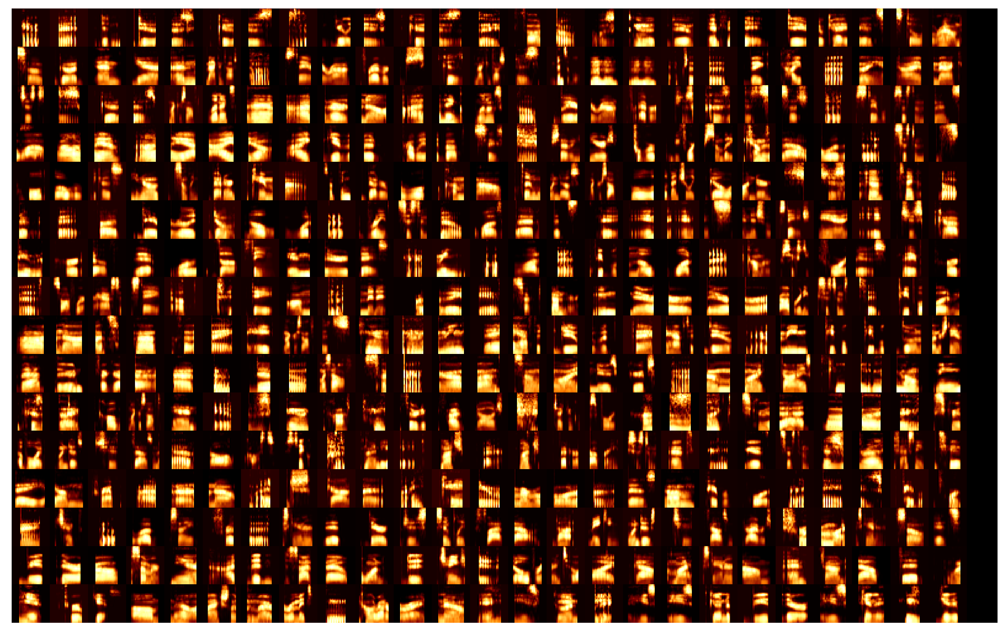

s16 11667


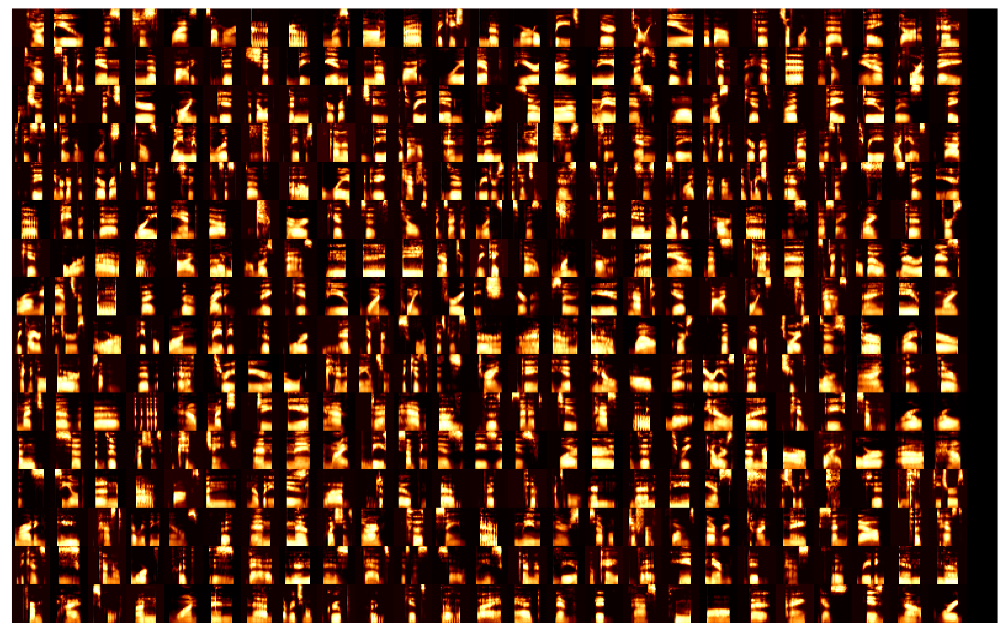

s17 5229


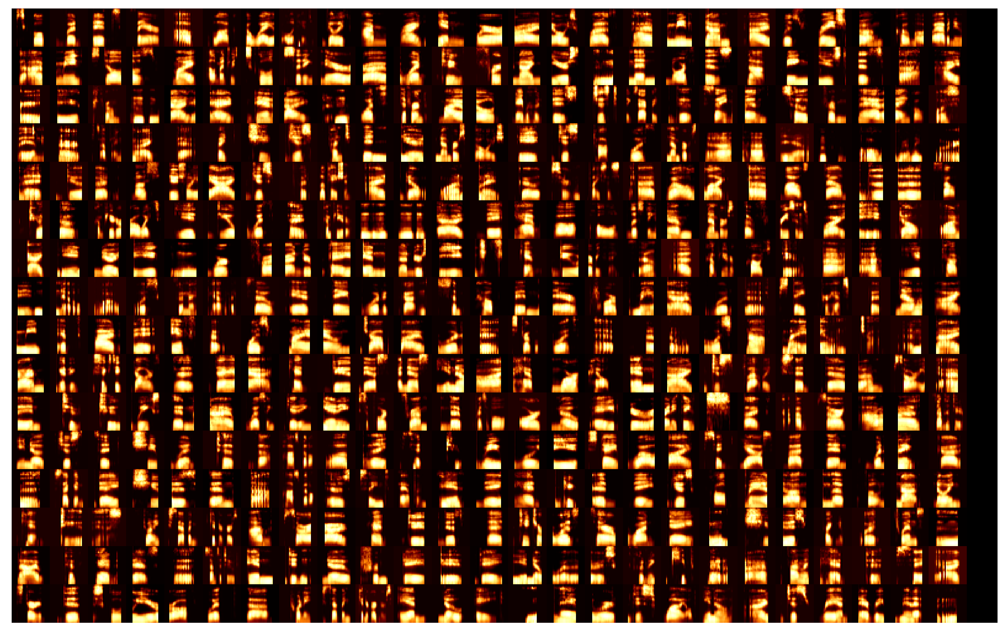

s18 9222


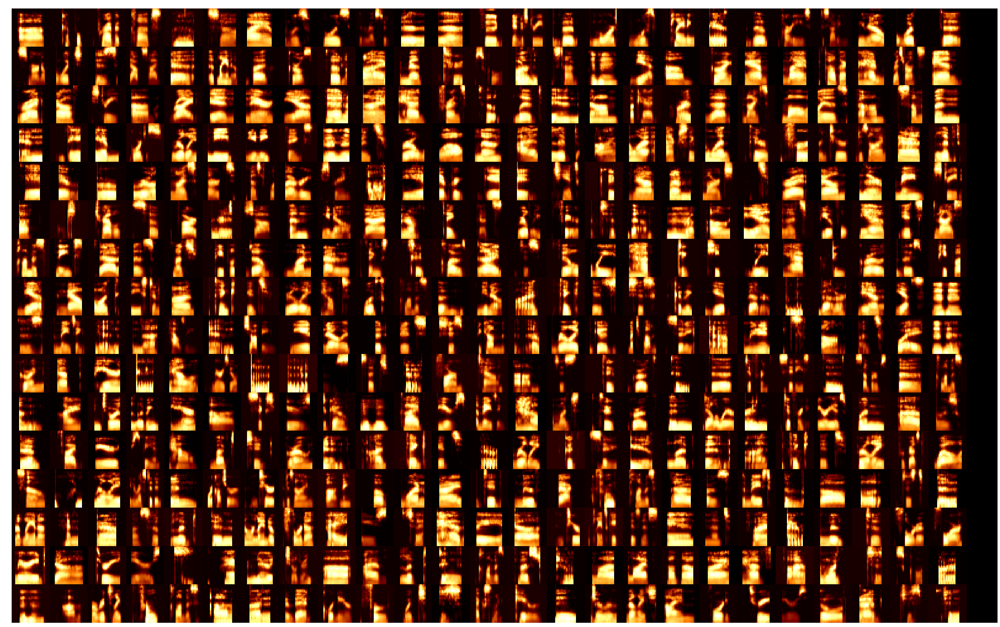

s19 10948


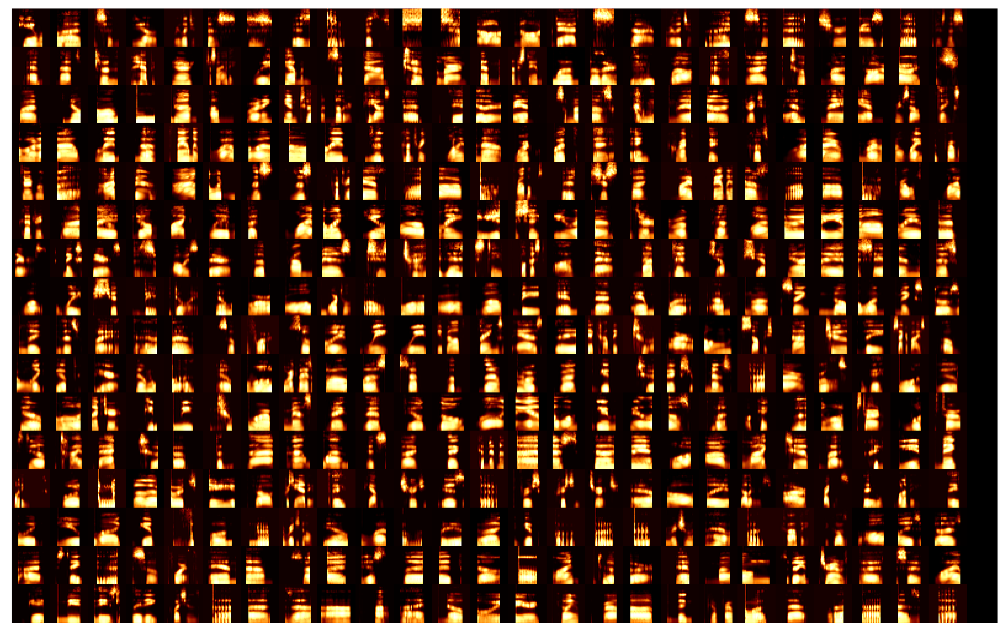

s20 3013


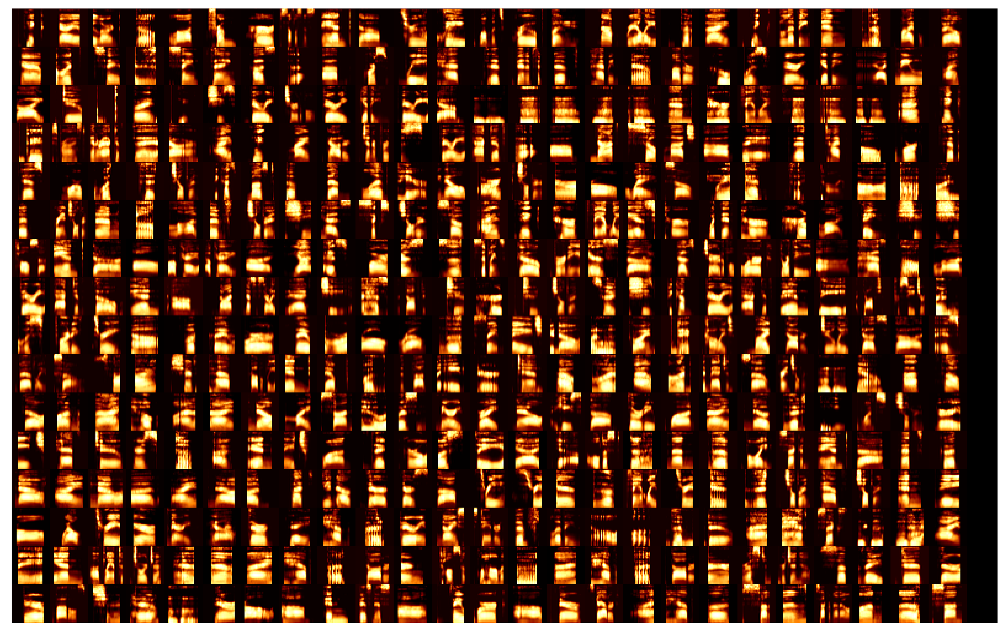

s21 4906


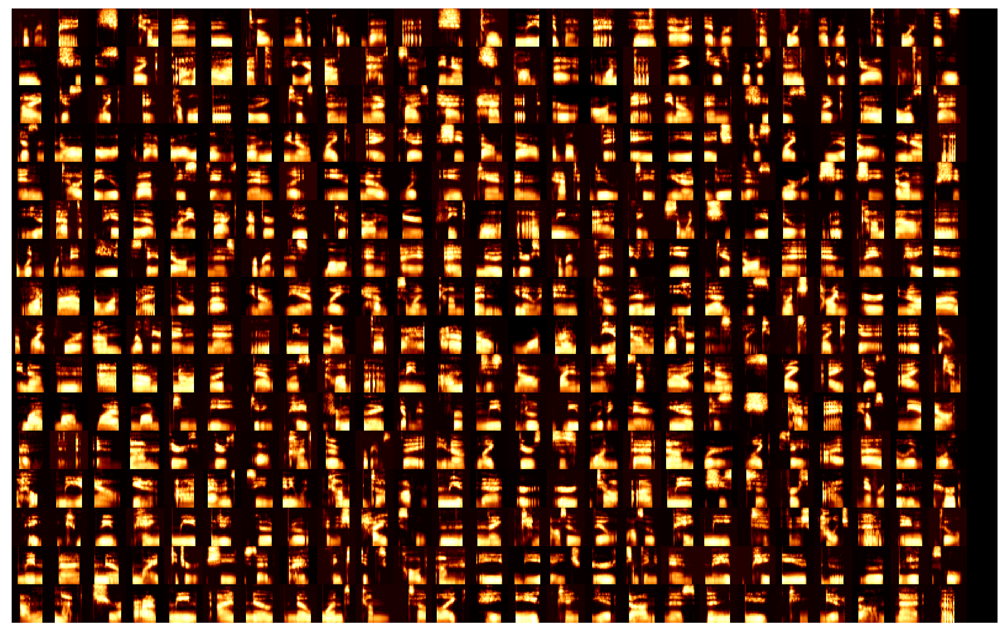

s22 6325


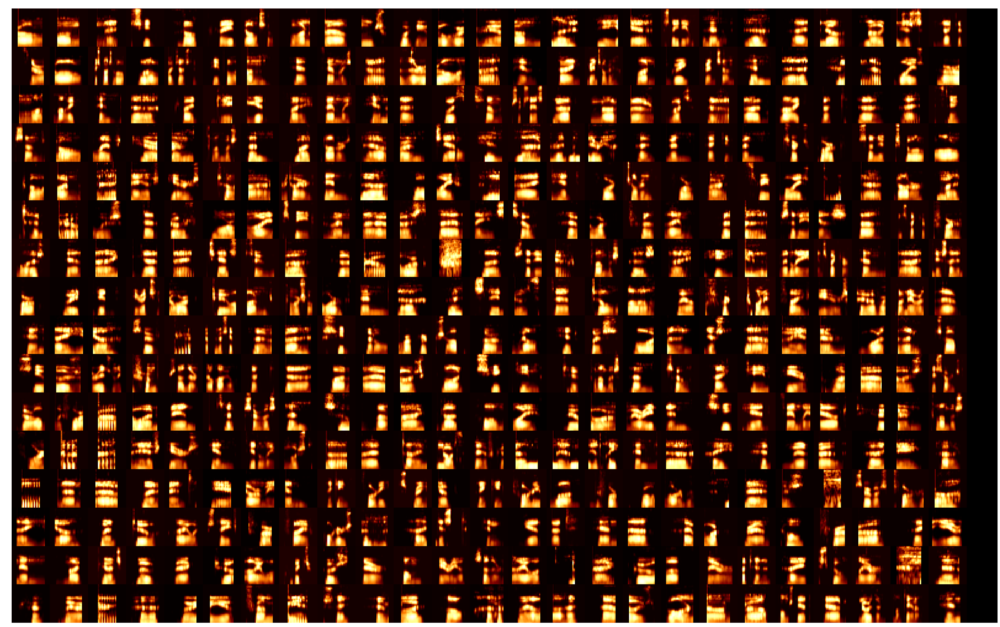

s23 6376


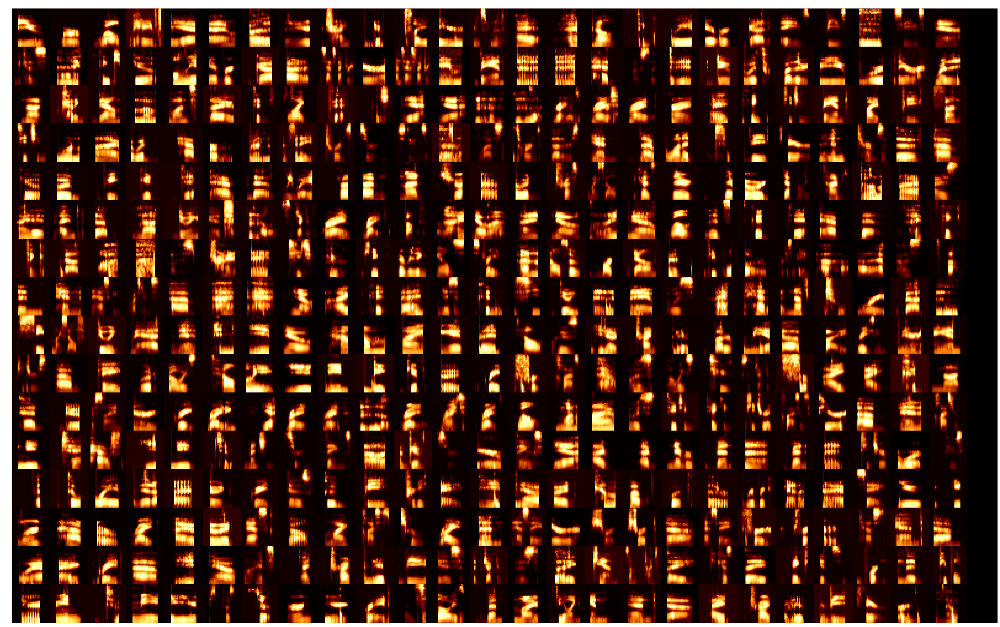

s24 7427


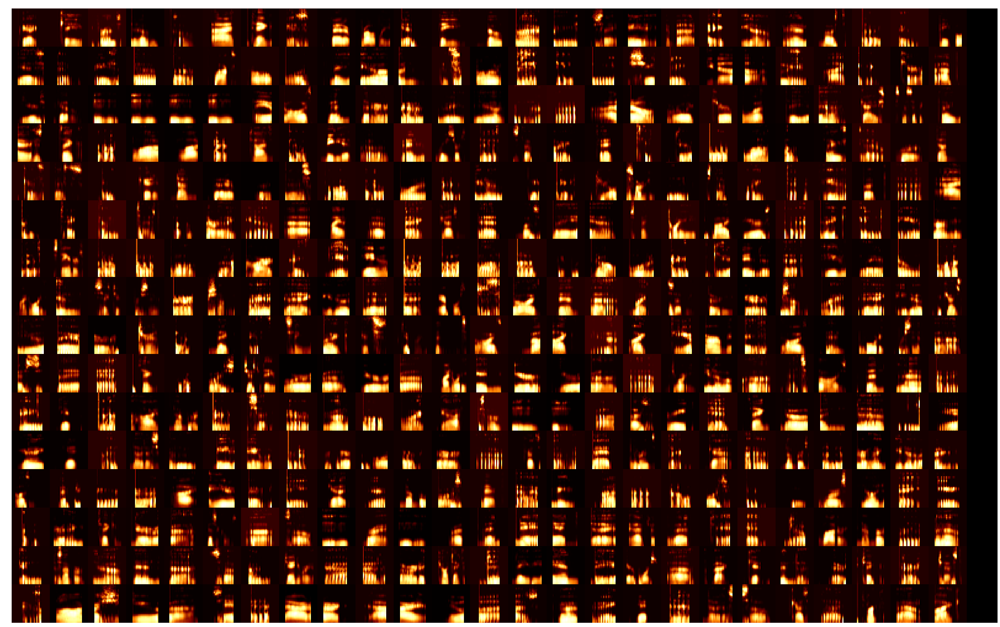

s25 8445


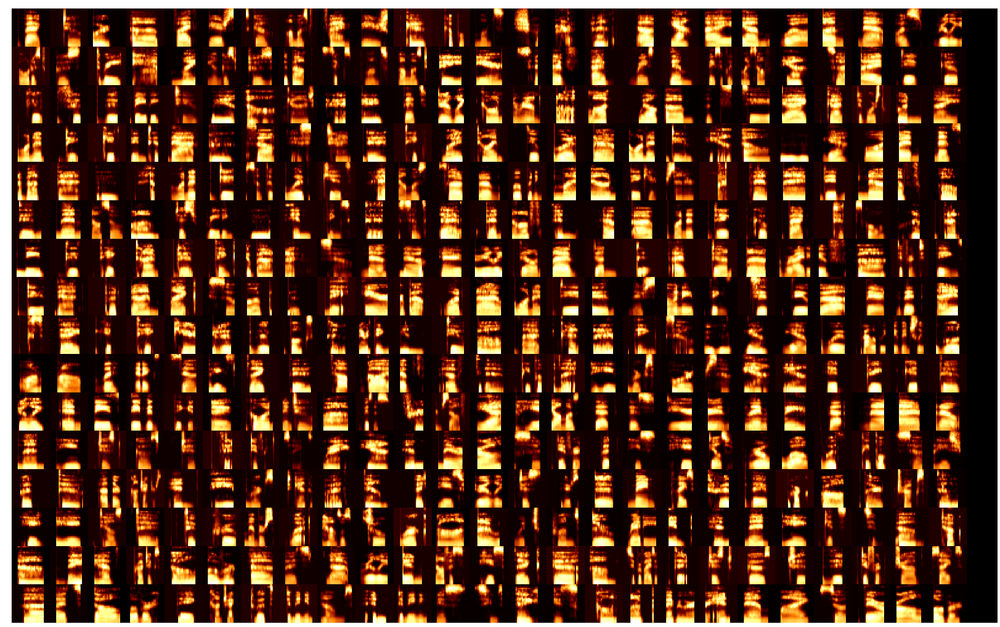

s26 4453


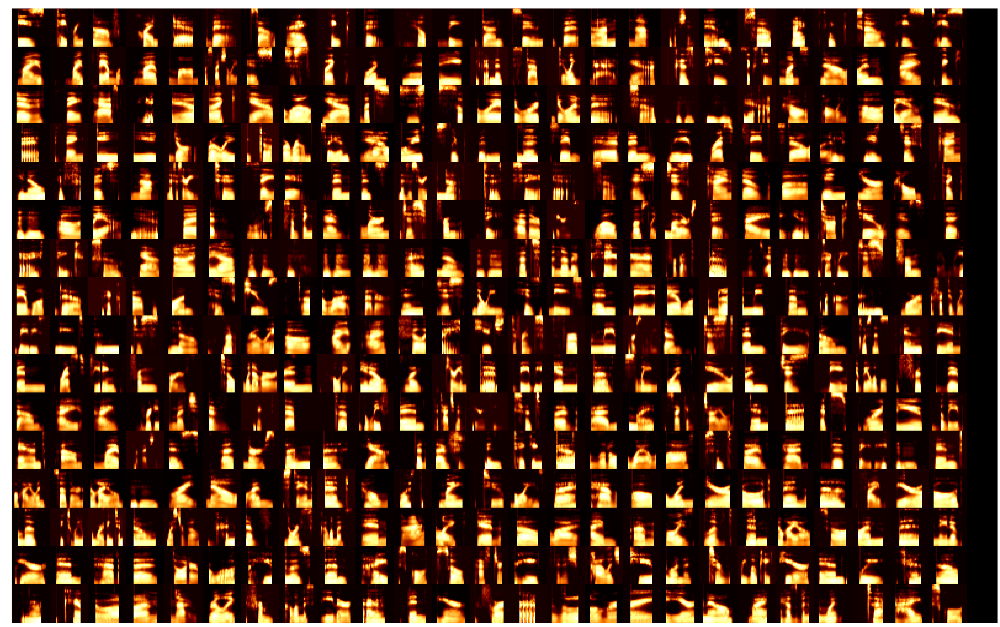

s27 6523


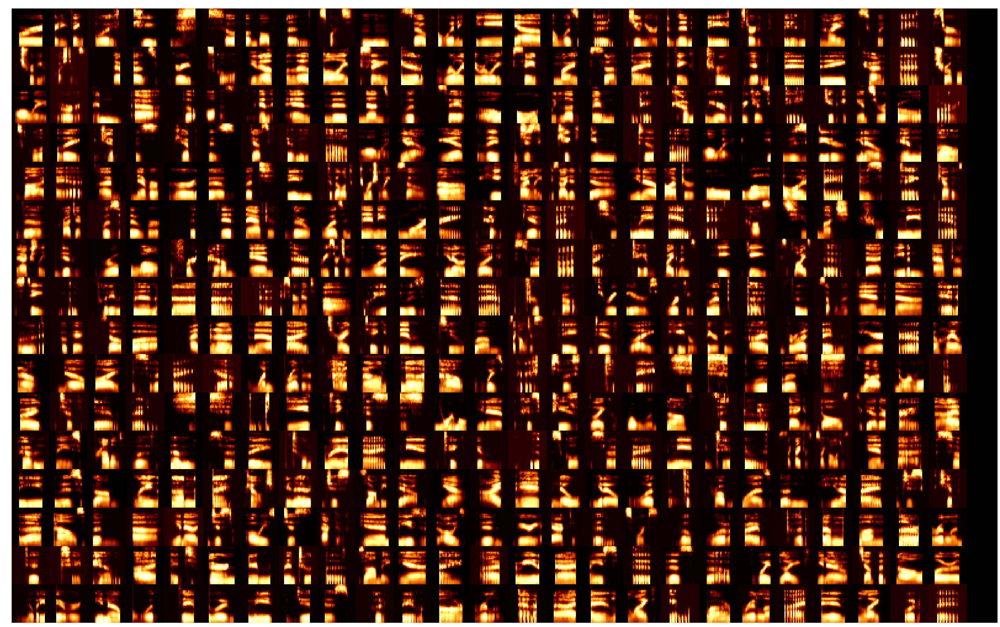

s28 7061


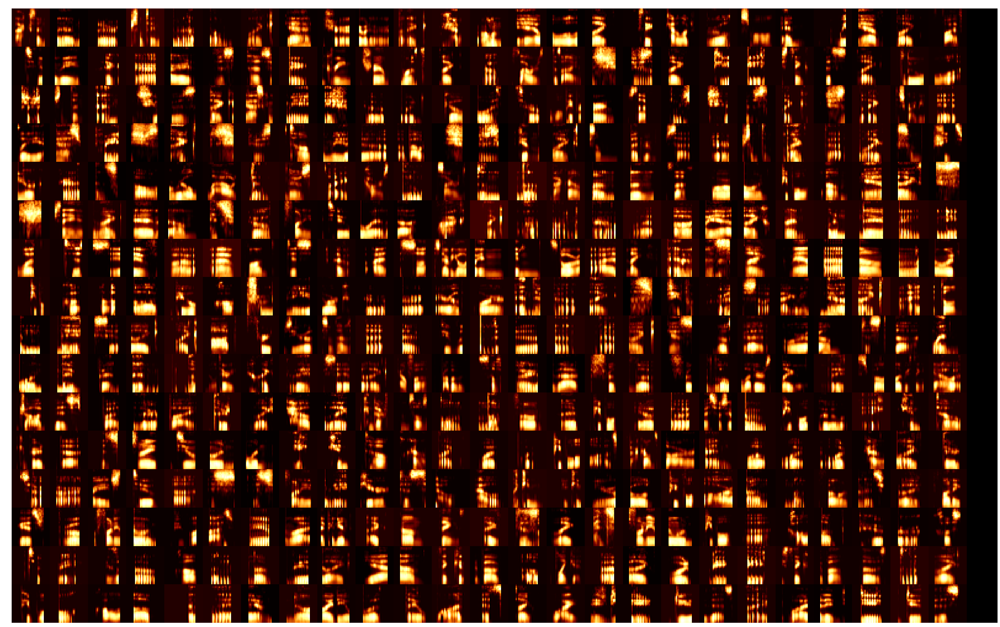

s29 8430


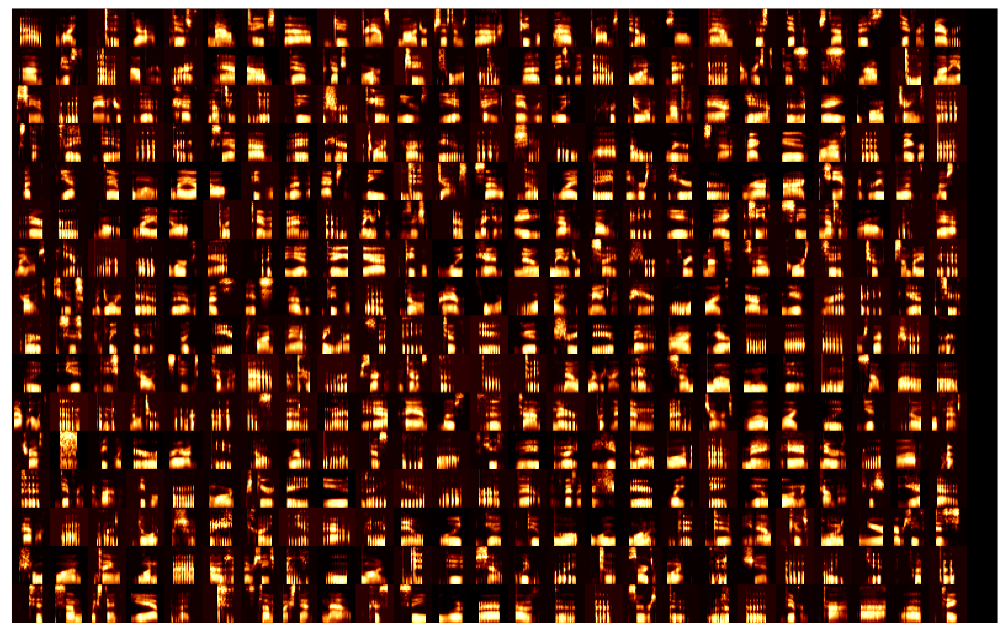

s30 7360


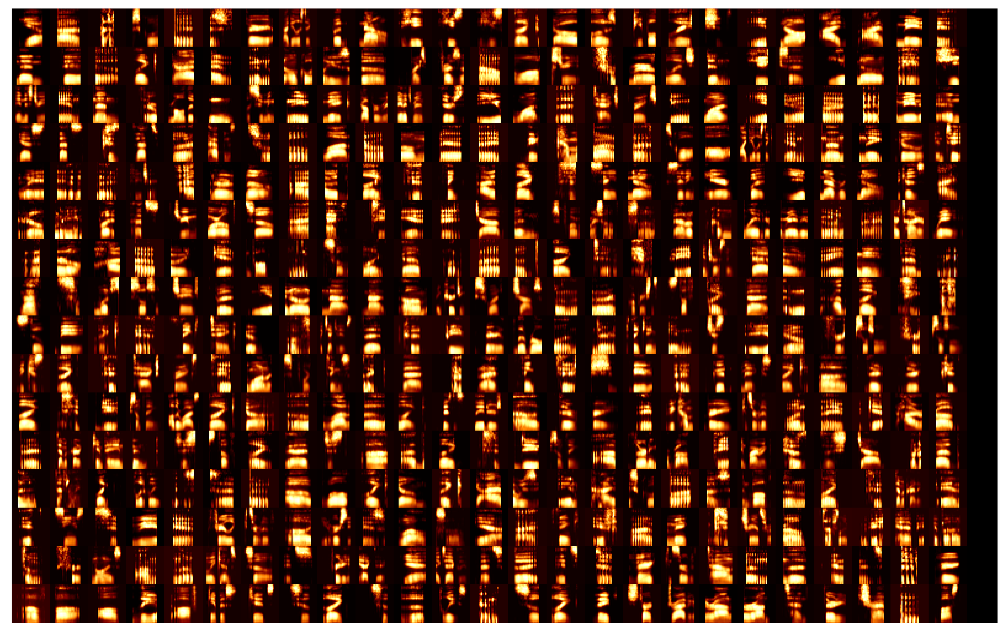

s31 5198


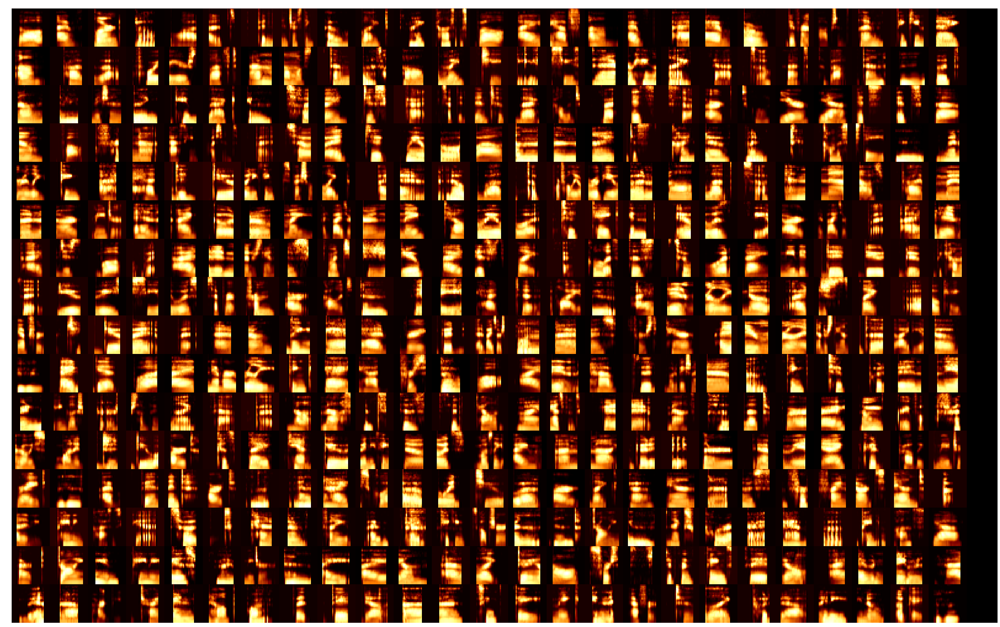

s32 5566


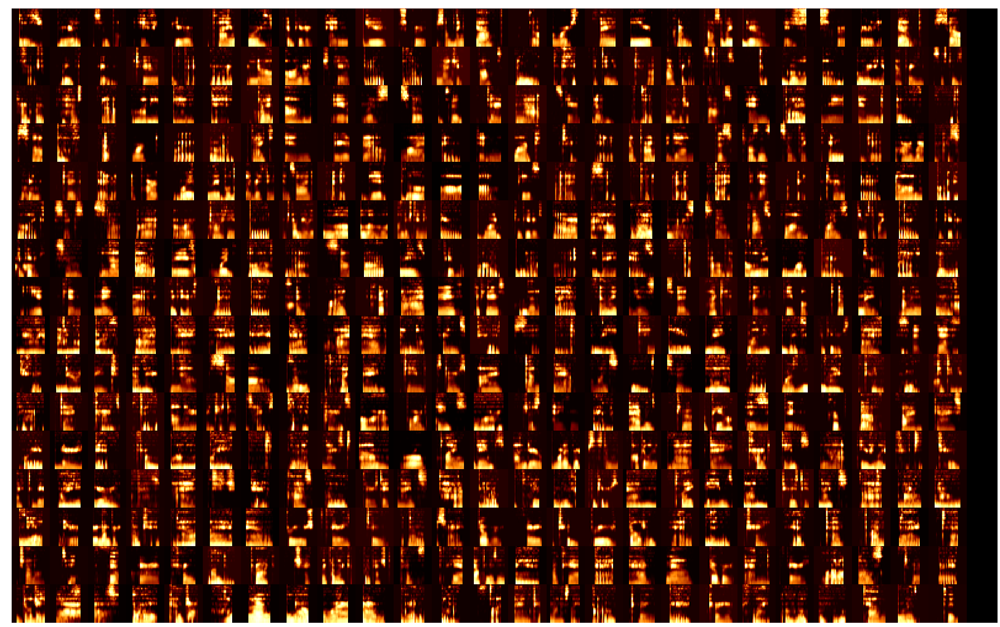

s33 5688


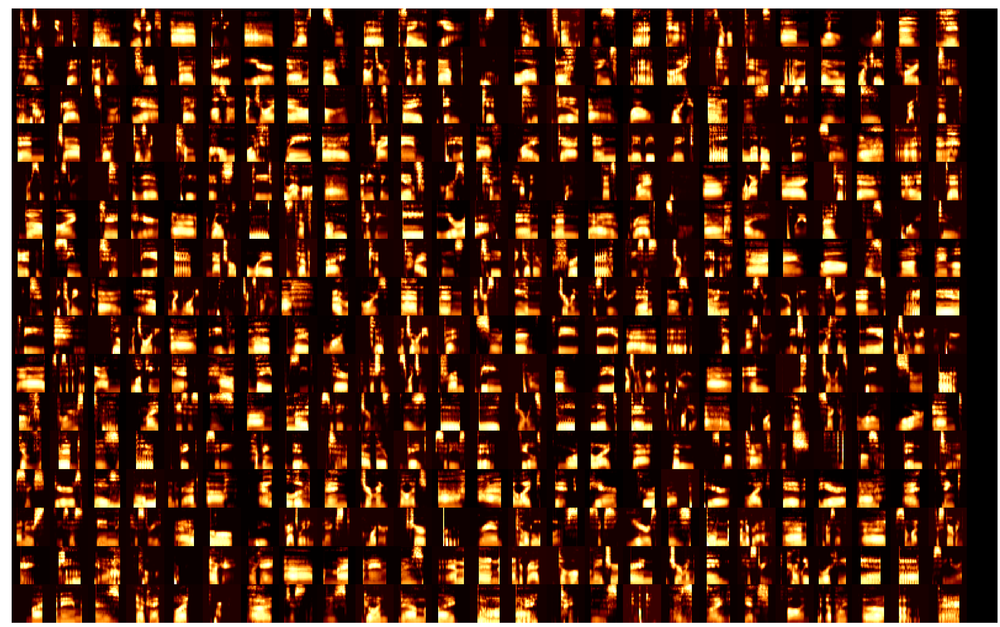

s34 7611


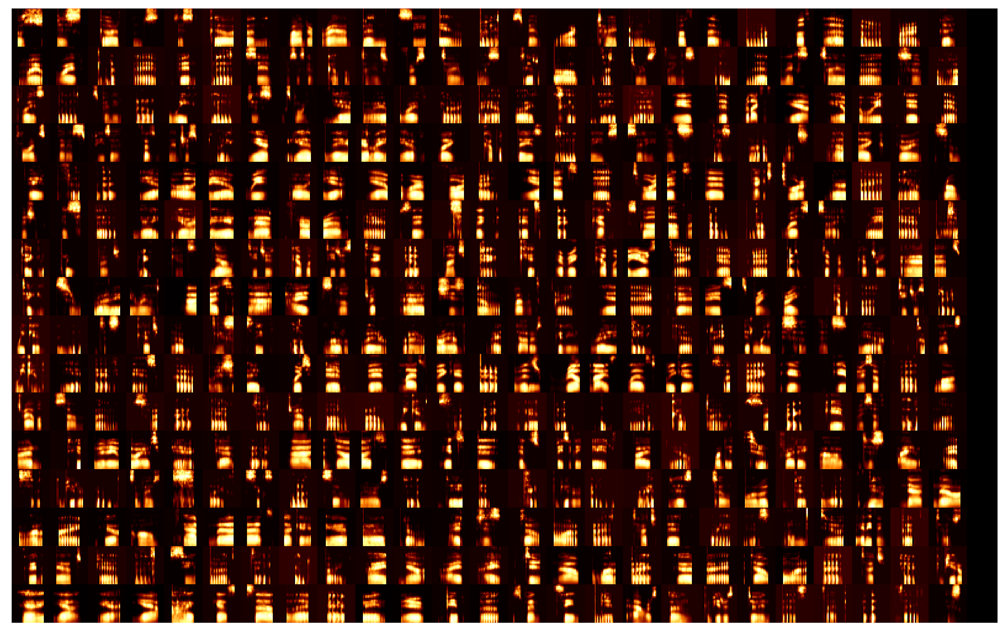

s35 8775


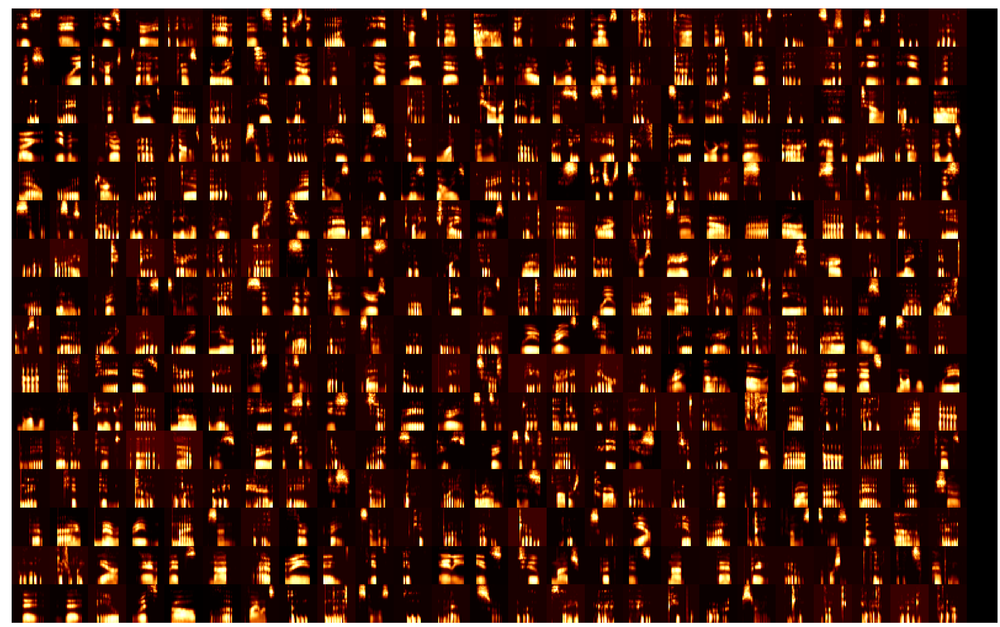

s36 6114


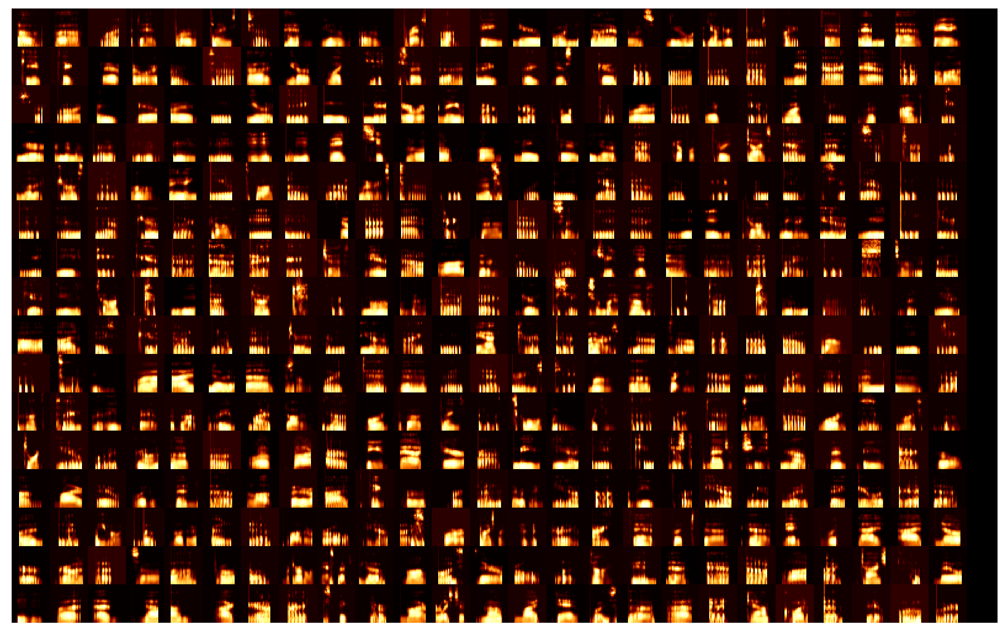

s37 5236


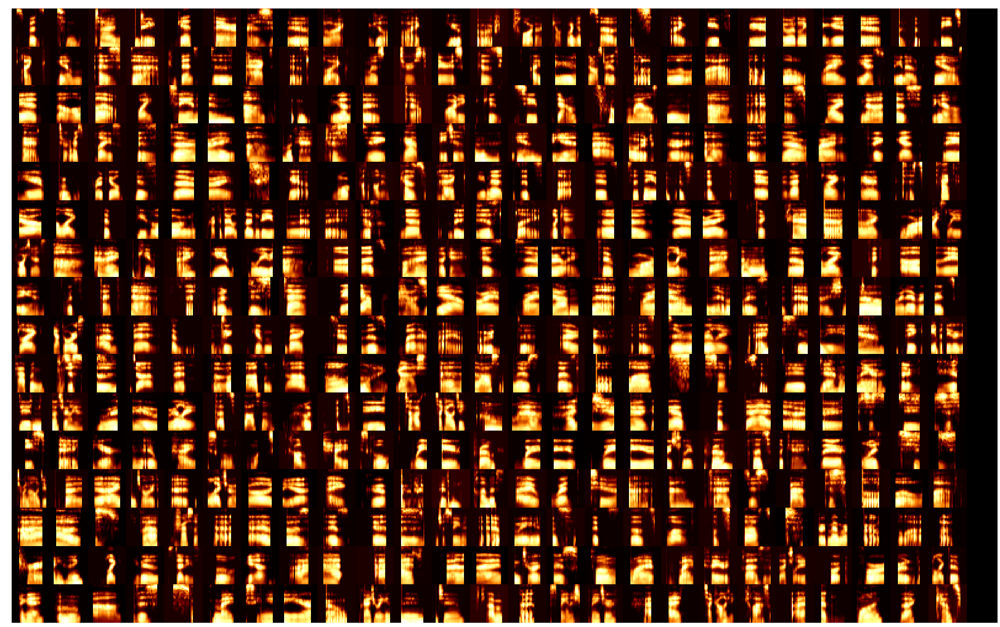

s38 7610


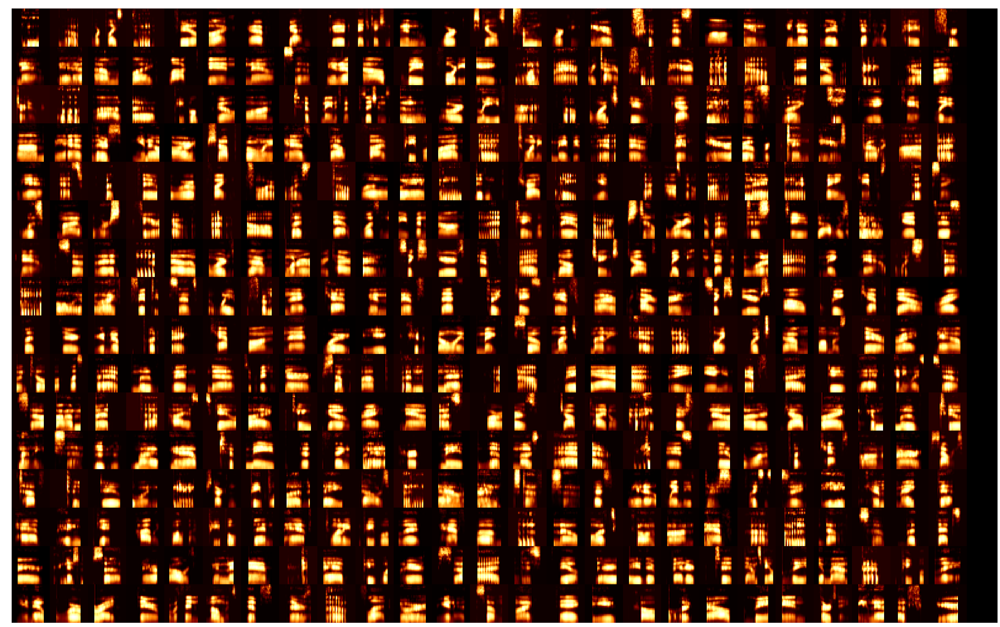

s39 6805


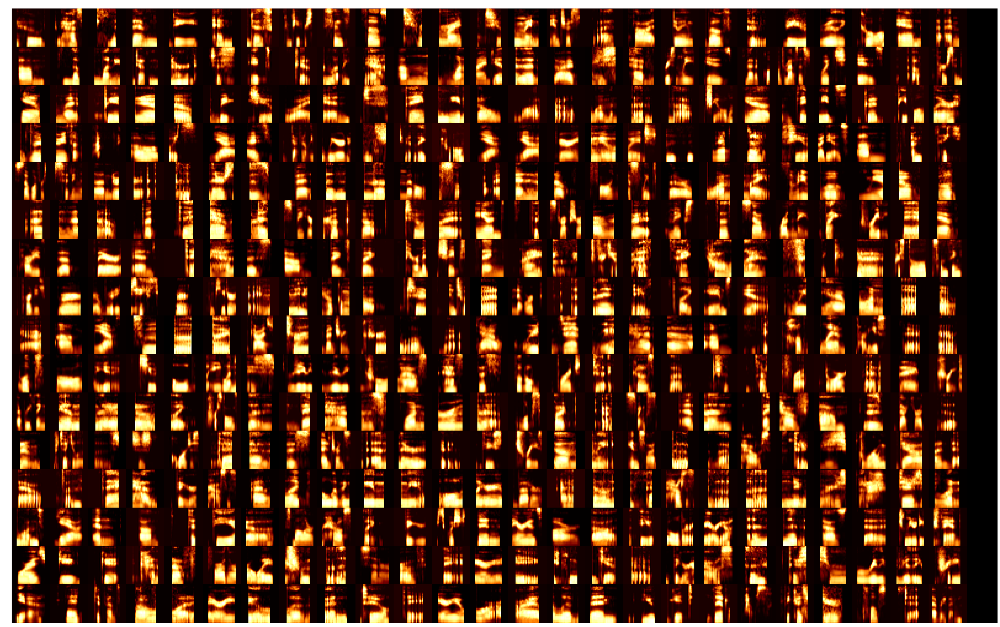

s40 7008


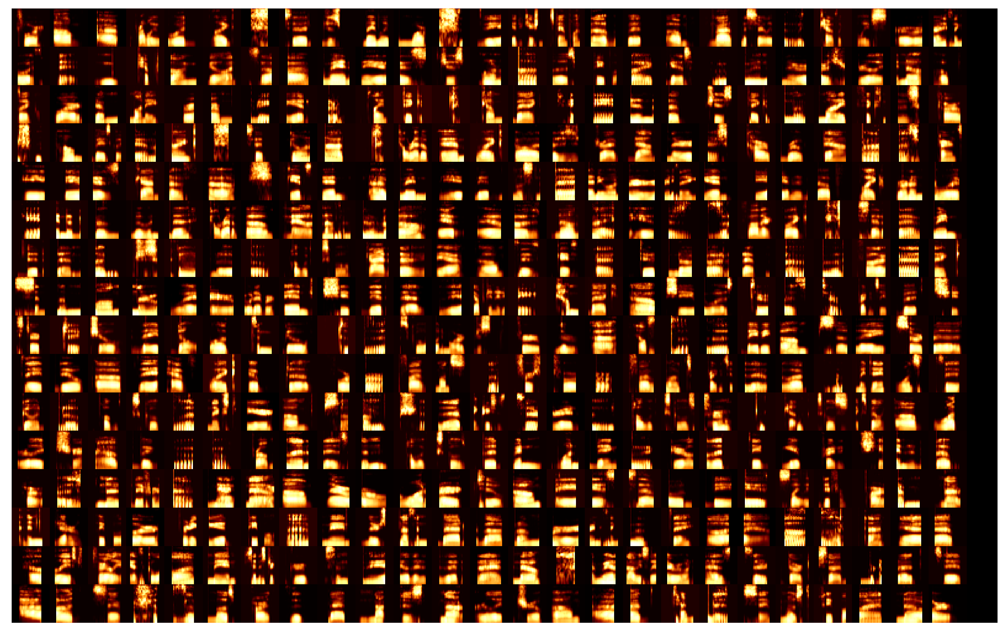

In [47]:
for indv in np.sort(syllable_df.indv.unique()):
    print(indv, np.sum(syllable_df.indv == indv))
    specs = np.array([i/np.max(i) for i in syllable_df[syllable_df.indv == indv].spectrogram.values])
    specs[specs<0] = 0
    draw_spec_set(specs, zoom=2,
                  maxrows=16, 
                  colsize=25)

### save dataset

In [48]:
save_loc = DATA_DIR / 'syllable_dfs' / DATASET_ID / 'words.pickle'
ensure_dir(save_loc)
syllable_df.to_pickle(save_loc)